# Simulated Annealing Algorithm for Cutting Stock Problem

# هدف کلی
مشکل برش قطعات با اندازه استاندارد از مواد استوک، مانند
رول کاغذ یا ورق فلز، به قطعات با اندازه های مشخص (درخواستی ) در حالی که هدر رفتن مواد را به حداقل می رساند.
این یک مسئله بهینه سازی در ریاضیات است که از کاربردها در صنعت ناشی می شود. از نظر پیچیدگی محاسباتی، مسئله
یک مسئله np hard است.



الگوریتم تبرید شبیه سازی شده یک الگوریتم فراابتکاری است که می تواند برای حل مسائل بهینه سازی ترکیبی استفاده شود. این الهام از فرآیند فیزیکی تبرید است که در آن یک ماده گرم می شود و سپس به آرامی سرد می شود تا به حالت کم انرژی برسد.

# الگوریتم کلی شبیه سازی تبرید
الگوریتم تبرید شبیه سازی شده با یک راه حل اولیه شروع می شود و به تدریج آن را با اصلاح مکرر راه حل و پذیرش تغییرات در صورتی که منجر به بهبود تابع هدف (در این مورد، طول تور) شود، بهبود می بخشد. با این حال، بر خلاف سایر الگوریتم‌های جستجوی محلی، تبرید شبیه‌سازی شده نیز تغییراتی را می‌پذیرد که به راه‌حل بدتری با احتمال مشخص منجر می‌شود. این احتمال توسط پارامتری به نام دما کنترل می شود که با گذشت زمان کاهش می یابد.

# الگوریتم برای حل مسئله برش قطعات
برای مسئله CSP، الگوریتم تبرید شبیه سازی شده به صورت زیر عمل می کند:
نکته مهم در پیاده سازی این الگوریتم این است که ما فرض میکنیم یک ارایه داریم که آن را پترن مینامیم که سولوشن ماست و بدین معناست که به ترتیب چه اندازه از مواد را برش بزنیم. این پترن، ارایه ای از اندیس های طول قطعات خواسته شده است و ترتیب برش آن ها را نشان میدهد.

#### ۱- مقدار دهی اولیه
ابتدا مقادیر ثابت و متغیرمان را مقدار دهی اولیه میکنیم. این مقادیر شامل اندازه قطعات استاندارد، تعداد قطعات مورد نیاز، آرایه اندازه قطعات خواسته شده، راه حل اولیه زندوم و فیتنس آن است. دمای اولیه و طول دما.
#### ۲- تنظیم دمای اولیه و ضریب سرمایش
ضمن آنکه متغیر های مربوط به دما را مقدار دهی کردیم، ضریب سرمایش را نیز تعیین میکنیم. این مقدار را در هنگام ساخت یک آبجکت از کلاس، ورودی میگیریم. مقدار این ضریب بسته به سوال دارد، ولی به طور کلی بین ۰.۸ تا  ۰.۹۹ می باشد. از آنجا که در این مسئله، تعداد کمترین مواد مصرفی، با میانگین مواد مصرفی در صورت یک راه حل رندوم تفاوت چندانی ندارد، ضریب سرمایش، تاثیر چندانی در رسیدن به جواب خواسته شده ندارد. من از همان مقادر که برای مسئله TSP استفاده کردم اینجا نیز استفاده میکنم.
#### ۳- پیدا کردن همسایه
حال میخواهیم از سولوشنی که داریم، به یک سولوشن دیگر برویم. برای اینکار میتوانیم یک همسایه رندوم از سولوشن موجود پیدا کنیم که این همسایه از طریق جا به جایی ترتیب دو اندیس در سولوشن موجود پیدا می شود.
#### ۴- همسایه با فیتنس بهتر
اگر همسایه پیدا شده، فیتنس بهتری نسبت به سولوشن موجود داشت، آن را به جای سولوشنمان قرار میدهیم.
#### ۵- همسایه با فیتنس بدتر
اگر همسایه پیدا شده، فیتنس بدتری نسبت به سولوشن موجود داشت، با استفاده از یک مقدار رندوم ویک تابع که نسبت تفاوت فیتنس به دما است و مقدار منفی آن، درون تابع exp قرار میگیرد را محاسبه میکنیم. اگر این مقدار از مقدار رندوم گفته شده بیشتر بود، این همسایه بد را جایگزین سولوشنمان میکنیم.
#### ۶- تکرار الگوریتم
مراحل 3-5 را برای هر دما تکرار میکنیم و دما را طبق تابع خنک کننده کاهش میدهیم.



# پیاده سازی

## ابتدا کتابخانه هایی که نیاز داریم را ایمپورت میکنیم.

In [206]:
import random
import numpy as np
import math

###  SimulatedAnnealing پیاده سازی کلاس اصلی 
کلاس SimulatedAnnealing شامل متدهای زیر است:

init (خود، اندازه استاندارد، تعداد قطعات مورد نیاز، عرض قطعه های مورد نیاز، دمای_ابتدایی، طول دما، آلفا):
این متد شی SimulatedAnnealing را با پارامترهای زیر مقداردهی اولیه می کند:

stock_size: اندازه هر قطعه استاندارد

require_number: تعداد سفارشاتی که باید برآورده شوند

require_width: لیستی از عرض های هر سفارش

initial_temperature: دمای اولیه برای فرآیند تبرید(بازپخت)

temperature_length: طول فرآیند تبرید (تعداد تکرار)

آلفا: نسبت خنک کننده برای فرآیند تبرید

<br />

#### initial ():
این روش حل و فیتنس شی SimulatedAnnealing را مقداردهی اولیه می کند.

#### fitness_function ( الگو):
این روش فیتنس یک الگوی راه حل داده شده را محاسبه می کند. فیتنس تعداد قطعات موجودی است که برای برآورده کردن سفارشات استفاده می شود.

#### cooling_ratio ( دما):
این روش نسبت خنک کننده را برای تکرار بعدی فرآیند تبرید محاسبه می کند. دمای فعلی را به عنوان ورودی می گیرد.

#### cooling_temprature():
این روش دمای فعلی فرآیند تبرید را با استفاده از نسبت خنک کننده به روز می کند.

#### get_neighbor ( الگو):
این روش یک الگوی راه حل همسایه را با مبادله تصادفی ترتیب برش دو سفارش ایجاد می کند.

#### next_teteration ():
این روش تکرار بعدی فرآیند بازپخت را انجام می دهد. یک الگوی راه حل همسایه ایجاد می کند، تغییر هزینه (تفاوت فیتنس) بین الگوهای فعلی و همسایه را محاسبه می کند و تصمیم می گیرد که آیا الگوی همسایه را به عنوان راه حل جدید بر اساس تغییر هزینه و دمای فعلی بپذیرد یا خیر.

#### run ():
این روش کل فرآیند بازپخت را برای تعداد تکرار مشخص شده اجرا می کند. این بهترین فیتنس یافت شده تا کنون در هر تکرار را چاپ می کند.

In [207]:
class SimulatedAnnealing:
    def __init__(self,stock_size,require_number,require_width,initial_temprature,temprature_length,alpha) -> None:
        #First, Define our constant variables
        self.stock_size = stock_size
        self.require_number = require_number
        self.require_width = require_width
        self.solution = list(random.sample(range(self.require_number), self.require_number))

        self.fitness = self.fitness_function(self.solution)
        self.temprature = initial_temprature
        self.temprature_length = temprature_length
        self.alpha = alpha
        
    def initial(self):
        self.solution = list(random.sample(range(self.require_number), self.require_number))
        self.fitness = self.fitness_function(self.solution)
        
    def fitness_function(self, pattern):
        stock_used = 0
        tmp_stock = 0
        for i in range(len(pattern)):       #0, 1, 2, 3
            tmp_stock += self.require_width[pattern[i]]
            if tmp_stock > self.stock_size:
                stock_used+=1
                tmp_stock = self.require_width[pattern[i]]
        stock_used+=1
        # stock used:
        fitness_value = stock_used
        return fitness_value  # Fitness value is the number of stock we used

    def cooling_ratio(self, temprature):
        return self.alpha*temprature
    
    def cooling_temprature(self):
        self.temprature = self.cooling_ratio(self.temprature)
        
    def get_neighbor(self,pattern):
        swapped_pattern = pattern.copy()
        req_1,req_2 = random.sample(range(self.require_number),2)
        swapped_pattern[req_1], swapped_pattern[req_2] = swapped_pattern[req_2], swapped_pattern[req_1]
        return swapped_pattern

    def next_iteration(self):
        neighbor = self.get_neighbor(self.solution)
        cost_change = self.fitness_function(neighbor) - self.fitness_function(self.solution)
        if cost_change < 0:
            self.solution = neighbor
            self.fitness = self.fitness_function(self.solution)
        else:
            random_q = random.random()
            # print(random_q,cost_change,self.temprature, math.exp(-1*cost_change/self.temprature))
            if random_q < math.exp(-1*cost_change/self.temprature):
                self.solution = neighbor
                self.fitness = self.fitness_function(self.solution)

    def run(self):
        for i in range(self.temprature_length):
            self.next_iteration()
            # print(self.fitness_function(self.solution))
            print(f'In temprature {self.temprature}th best fitness is:{self.fitness}')
            self.temprature = self.cooling_ratio(self.temprature)



In [244]:
def print_stocks(stock_size,pattern,required_width):
    tmp_stock = []
    stock_used = 0
    for i in range(len(pattern)):       
        if sum(tmp_stock)+required_width[pattern[i]] <= stock_size:
            tmp_stock.append(required_width[pattern[i]]) 
        elif sum(tmp_stock)+sum(tmp_stock)+required_width[pattern[i]] > stock_size:
            stock_used+=1
            print(f"Stock {stock_used}th:{tmp_stock}")
            tmp_stock = [required_width[pattern[i]]]
    stock_used+=1
    print(f"Stock {stock_used}th:{tmp_stock}")
    fitness_value = stock_used
    return fitness_value

## تابع کلی الگوریتم
برای راحتی کار و قابل استفاده بودن الگوریتم، یک تابع مینویسیم که یک شی از کلاس الگوریتم ما ساخته، یک بریک پوینت میگیرد، که الگوریتم را برای ما تا برقراری آن شرایط اجرا میکند.
همچنین نسل ها را در یک ارایه ذخیره کرده و بهترین تعداد قطعه استاندارد مورد نیاز در آن نسل را در یک ارایه میریزیم تا در صورت خواستن کشیدن نمودار، بتوانیم از آن ها استفاده کنیم. به علاوه، بهترین جواب تا نسلی که در ان هستیم را نیز چاپ میکنیم.

In [246]:
def min_csp(model: SimulatedAnnealing, stop_point):
    MAX_INT = 10e12
    csp = model
    iteration_x = []
    iteration_y = []
    best_answer = [csp.fitness,csp.solution]
    temprature_counter = 0
    while (csp.fitness > stop_point) and temprature_counter < csp.temprature_length:
        iteration_x.append(temprature_counter)
        iteration_y.append(csp.fitness)
        csp.next_iteration()
        csp.cooling_temprature()
        print(f'In ietration {temprature_counter}th and temprature{csp.temprature} best fitness is:{csp.fitness}')
        if csp.fitness < best_answer[0]:
            best_answer[0] = csp.fitness
            best_answer[1] = csp.solution
        temprature_counter += 1

    print('----------------------------------------')
    print(f"\n{csp.require_number}-required piece problem solved in temprature length of {temprature_counter}th . And best fitness(minimum number) is: { best_answer[0]} with pattern {best_answer[1]}")
    print('----------------------------------------')
    print_stocks(stock_size=csp.stock_size,pattern=best_answer[1],required_width=csp.require_width)
    print('----------------------------------------')
    return (iteration_x, iteration_y, best_answer)


In [210]:
def read_file(filename):
    file = open(filename)
    inp = file.read()
    file.close()
    stock_size = int(inp.split('\n')[0].split(' ')[-1])
    req = list(map(int,inp.split('\n')[3].split(',')))
    return stock_size, req

# تست کیس اول


### خواندن فایل
تست کیس اول که حاوی ۱۴۰ سفارش هست را از دایرکتوری که در آن قرار داریم، باز میکنیم.
### تعیین پارامتر ها
حال پارامتر های موردنظر را مقدار دهی میکنیم. مقادیر اندازه استاندارد و سفارش ها که ثابت هستند را میدهیم. حال نوبیت به پارامتر های اصلی کلاس میرسد. من پس از همان پارامتر هایی که در مسئله TSP استفاده کردم اینجا نیز استفاده میکنم و تغییر چندانی با عوض کردن ها مشاهده نمیشود.
نکته مهم در پیاده سازی این الگوریتم این است که ما فرض میکنیم یک ارایه داریم که آن را پترن مینامیم که سولوشن ماست و بدین معناست که به ترتیب چه اندازه از مواد را برش بزنیم. این پترن، ارایه ای از اندیس های طول قطعات خواسته شده است و ترتیب برش آن ها را نشان میدهد.
از آنجا که در این مسئله، تعداد کمترین مواد مصرفی، با میانگین مواد مصرفی در صورت یک راه حل رندوم تفاوت چندانی ندارد، ضریب سرمایش، تاثیر چندانی در رسیدن به جواب خواسته شده ندارد. من از همان مقادر که برای مسئله TSP استفاده کردم اینجا نیز استفاده میکنم.

In [211]:
stock_size, required_width = read_file("input1.stock")
model = SimulatedAnnealing( stock_size=stock_size,require_number=(len(required_width)),require_width=required_width,initial_temprature=1,temprature_length=50000,alpha=0.9999)
model.initial()
x, y, best_ans = min_csp(model=model,stop_point=0)

In ietration 0th and temprature0.9999 best fitness is:63
In ietration 1th and temprature0.9998000100000001 best fitness is:63
In ietration 2th and temprature0.9997000299990001 best fitness is:63
In ietration 3th and temprature0.9996000599960002 best fitness is:63
In ietration 4th and temprature0.9995000999900007 best fitness is:63
In ietration 5th and temprature0.9994001499800017 best fitness is:63
In ietration 6th and temprature0.9993002099650037 best fitness is:63
In ietration 7th and temprature0.9992002799440072 best fitness is:63
In ietration 8th and temprature0.9991003599160128 best fitness is:63
In ietration 9th and temprature0.9990004498800211 best fitness is:63
In ietration 10th and temprature0.9989005498350332 best fitness is:63
In ietration 11th and temprature0.9988006597800497 best fitness is:63
In ietration 12th and temprature0.9987007797140718 best fitness is:63
In ietration 13th and temprature0.9986009096361004 best fitness is:63
In ietration 14th and temprature0.99850104

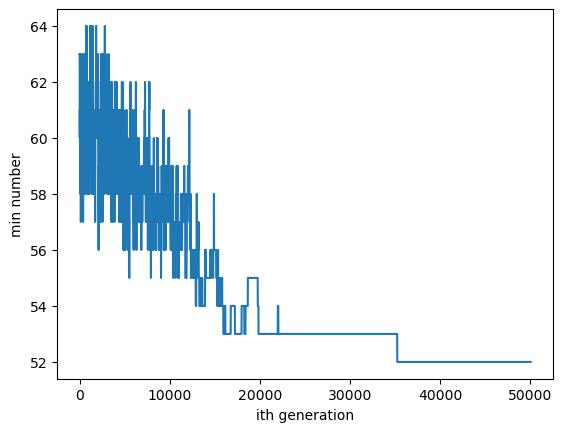

In [212]:
import matplotlib.pyplot as plt
plt.plot(x, y)
plt.xlabel("ith generation")
plt.ylabel("min number")

plt.show()

# تحلیل
همانطور که مشاهده میکنیم، بعد از گذشت نسل نسبتا کمی به جواب خواسته شده میرسیم. یه نکته جالبی که در نمودار وجود دارد این است که میزان بالا و پایین شدن فیتنس در نسل های اولیه، به شدت زیاد است و نوسان دارد. حال هر جه دما سردتر میشود، تابع احتمال انتخاب رندوم ما نیز کمتر شده و این نوسان نیز کم میشود. به طور کلی، این الگوریتم در مقایسه با الگوریتم های قبلی، در ایتریشن های دیرتری به جواب میرسد. امااااا، از انجا که محاسبات بسیار کمی دارد، زمان رسیدن به جواب، از خیلی از الگوریتم ها، مانند PSO یا ژنتیک الگوریتم، بسیار کمتر و در حدود چند ثانیه است.
همچنین همانطور که پیش تر گفتم، بدلیل کم بودن تفاوت سولوشن های مختلفمان در این مسئله، شکل مسئله پلکانی میشود درصورتی که در مسئله TSP نمودار بیشتر شبیه یک نمودار با y های پیوسته بود.

**********************************************************************************

# تست کیس دوم

### خواندن فایل
تست کیس اول که حاوی ۱۴۰ سفارش هست را از دایرکتوری که در آن قرار داریم، باز میکنیم.
### تعیین پارامتر ها
حال پارامتر های موردنظر را مقدار دهی میکنیم. مقادیر اندازه استاندارد و سفارش ها که ثابت هستند را میدهیم. حال نوبیت به پارامتر های اصلی کلاس میرسد. من پس از همان پارامتر هایی که در تست کیس قبلی استفاده کردم اینجا هم استفاده میکنم.
از آنجا که در این مسئله، تعداد کمترین مواد مصرفی، با میانگین مواد مصرفی در صورت یک راه حل رندوم تفاوت چندانی ندارد، ضریب سرمایش یا همان پویش، تاثیر چندانی در رسیدن به جواب خواسته شده ندارد. من از همان مقادر که برای مسئله TSP استفاده کردم اینجا نیز استفاده میکنم. براساس نمودار نیز اینجا مشاهده میکنیم که در ایتریشن ۴۰۰۰۰ به جواب بسیااااار خوبی میرسیم.

In [247]:
stock_size, required_width = read_file("input2.stock")
model = SimulatedAnnealing( stock_size=stock_size,require_number=(len(required_width)),require_width=required_width,initial_temprature=1,temprature_length=50000,alpha=0.9999)
model.initial()
x, y, best_ans = min_csp(model=model,stop_point=0)

In ietration 0th and temprature0.9999 best fitness is:88
In ietration 1th and temprature0.9998000100000001 best fitness is:89
In ietration 2th and temprature0.9997000299990001 best fitness is:88
In ietration 3th and temprature0.9996000599960002 best fitness is:88
In ietration 4th and temprature0.9995000999900007 best fitness is:88
In ietration 5th and temprature0.9994001499800017 best fitness is:88
In ietration 6th and temprature0.9993002099650037 best fitness is:88
In ietration 7th and temprature0.9992002799440072 best fitness is:88
In ietration 8th and temprature0.9991003599160128 best fitness is:88
In ietration 9th and temprature0.9990004498800211 best fitness is:88
In ietration 10th and temprature0.9989005498350332 best fitness is:89
In ietration 11th and temprature0.9988006597800497 best fitness is:89
In ietration 12th and temprature0.9987007797140718 best fitness is:89
In ietration 13th and temprature0.9986009096361004 best fitness is:89
In ietration 14th and temprature0.99850104

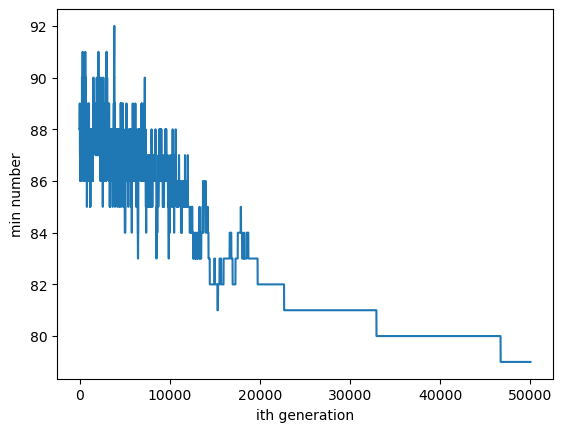

In [248]:
import matplotlib.pyplot as plt
plt.plot(x, y)
plt.xlabel("ith generation")
plt.ylabel("min number")

plt.show()

# تحلیل
همانطور که مشاهده میکنیم، مانند تست کیس اول بعد از گذشت نسل نسبتا کمی به جواب خواسته شده میرسیم. یه نکته جالبی که در نمودار وجود دارد این است که میزان بالا و پایین شدن فیتنس در نسل های اولیه، به شدت زیاد است و نوسان دارد. حال هر جه دما سردتر میشود، تابع احتمال انتخاب رندوم ما نیز کمتر شده و این نوسان نیز کم میشود. به طور کلی، این الگوریتم در مقایسه با الگوریتم های قبلی، در ایتریشن های دیرتری به جواب میرسد. امااااا، از انجا که محاسبات بسیار کمی دارد، زمان رسیدن به جواب، از خیلی از الگوریتم ها، مانند PSO یا ژنتیک الگوریتم، بسیار کمتر و در حدود چند ثانیه است.
همچنین همانطور که پیش تر گفتم، بدلیل کم بودن تفاوت سولوشن های مختلفمان در این مسئله، شکل مسئله پلکانی میشود درصورتی که در مسئله TSP نمودار بیشتر شبیه یک نمودار با y های پیوسته بود.
همچنین، بدون تغییر دادن پارامتر ها نسبت به تست کیس قبلی، به جواب خواسته شده میرسیم.

****************************************************************************************************

# تست کیس سوم

### خواندن فایل
تست کیس سوم که حاوی ۸۶۰ سفارش هست را از دایرکتوری که در آن قرار داریم، باز میکنیم.
### تعیین پارامتر ها
حال پارامتر های موردنظر را مقدار دهی میکنیم. مقادیر اندازه استاندارد و سفارش ها که ثابت هستند را میدهیم. حال نوبیت به پارامتر های اصلی کلاس میرسد. من پس از همان پارامتر هایی که در تست کیس های قبلی استفاده کردم اینجا هم استفاده میکنم.
از آنجا که در این مسئله، تعداد کمترین مواد مصرفی، با میانگین مواد مصرفی در صورت یک راه حل رندوم تفاوت چندانی ندارد، ضریب سرمایش یا همان پویش، تاثیر چندانی در رسیدن به جواب خواسته شده ندارد. من از همان مقادر که برای مسئله TSP استفاده کردم اینجا نیز استفاده میکنم. براساس نمودار نیز اینجا مشاهده میکنیم که در ایتریشن ۲۰۰۰۰ به جواب بسیااااار خوبی میرسیم.


In [215]:
stock_size, required_width = read_file("input3.stock")
model = SimulatedAnnealing( stock_size=stock_size,require_number=(len(required_width)),require_width=required_width,initial_temprature=1,temprature_length=50000,alpha=0.9999)
model.initial()
x, y, best_ans = min_csp(model=model,stop_point=0)

In ietration 0th and temprature0.9999 best fitness is:116
In ietration 1th and temprature0.9998000100000001 best fitness is:116
In ietration 2th and temprature0.9997000299990001 best fitness is:116
In ietration 3th and temprature0.9996000599960002 best fitness is:116
In ietration 4th and temprature0.9995000999900007 best fitness is:116
In ietration 5th and temprature0.9994001499800017 best fitness is:116
In ietration 6th and temprature0.9993002099650037 best fitness is:116
In ietration 7th and temprature0.9992002799440072 best fitness is:116
In ietration 8th and temprature0.9991003599160128 best fitness is:116
In ietration 9th and temprature0.9990004498800211 best fitness is:115
In ietration 10th and temprature0.9989005498350332 best fitness is:115
In ietration 11th and temprature0.9988006597800497 best fitness is:115
In ietration 12th and temprature0.9987007797140718 best fitness is:114
In ietration 13th and temprature0.9986009096361004 best fitness is:114
In ietration 14th and tempra

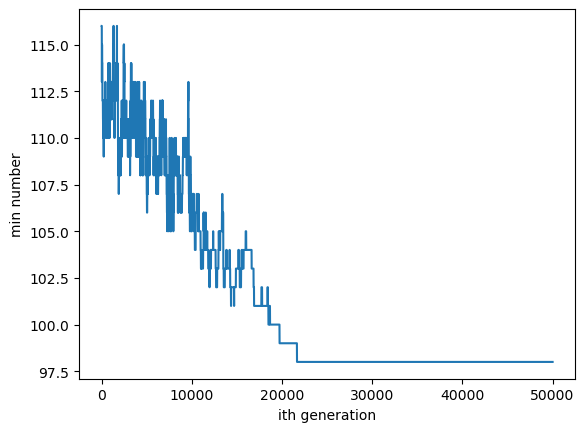

In [216]:
import matplotlib.pyplot as plt
plt.plot(x, y)
plt.xlabel("ith generation")
plt.ylabel("min number")

plt.show()

# تحلیل
همانطور که مشاهده میکنیم، مانند تست کیس های قبل بعد از گذشت نسل نسبتا کمی به جواب خواسته شده میرسیم. یه نکته جالبی که در نمودار وجود دارد این است که میزان بالا و پایین شدن فیتنس در نسل های اولیه، به شدت زیاد است و نوسان دارد. حال هر جه دما سردتر میشود، تابع احتمال انتخاب رندوم ما نیز کمتر شده و این نوسان نیز کم میشود. به طور کلی، این الگوریتم در مقایسه با الگوریتم های قبلی، در ایتریشن های دیرتری به جواب میرسد. امااااا، از انجا که محاسبات بسیار کمی دارد، زمان رسیدن به جواب، از خیلی از الگوریتم ها، مانند PSO یا ژنتیک الگوریتم، بسیار کمتر و در حدود چند ثانیه است.
همچنین همانطور که پیش تر گفتم، بدلیل کم بودن تفاوت سولوشن های مختلفمان در این مسئله، شکل مسئله پلکانی میشود درصورتی که در مسئله TSP نمودار بیشتر شبیه یک نمودار با y های پیوسته بود.
همچنین، بدون تغییر دادن پارامتر ها نسبت به تست کیس قبلی، به جواب خواسته شده میرسیم.
نکته دیگر در این سوال این است که حتی در ایتریشن های بسیار اولیه هم، جواب های خیلی خوبی میگیریم.
 و در ایتریشن ۲۰۰۰۰ یه جواب میرسیم. همچنین میزان نوسان در این تست کیس، نسبت به تست کیس قبلی بیشتر است و احتمالا بدان معناست که دما دیرتر کاهش میابد.

****************************************************************************************************

# تست کیس چهارم

### خواندن فایل
تست کیس چهارم که حاوی ۹۰۰ سفارش هست را از دایرکتوری که در آن قرار داریم، باز میکنیم.
### تعیین پارامتر ها
حال پارامتر های موردنظر را مقدار دهی میکنیم. مقادیر اندازه استاندارد و سفارش ها که ثابت هستند را میدهیم. حال نوبت به پارامتر های اصلی کلاس میرسد. من پس از همان پارامتر هایی که در تست کیس های قبلی استفاده کردم اینجا هم استفاده میکنم.
از آنجا که در این مسئله، تعداد کمترین مواد مصرفی، با میانگین مواد مصرفی در صورت یک راه حل رندوم تفاوت چندانی ندارد، ضریب سرمایش یا همان پویش، تاثیر چندانی در رسیدن به جواب خواسته شده ندارد. من از همان مقادر که برای مسئله TSP استفاده کردم اینجا نیز استفاده میکنم. براساس نمودار نیز اینجا مشاهده میکنیم که در ایتریشن ۲۰۰۰۰ به جواب خواسته شده و در ایتریشن ۴۰۰۰۰ به جواب بسیااااار خوبی میرسیم.


In [249]:
stock_size, required_width = read_file("input4.stock")
model = SimulatedAnnealing( stock_size=stock_size,require_number=(len(required_width)),require_width=required_width,initial_temprature=1,temprature_length=100000,alpha=0.9999)
model.initial()
x, y, best_ans = min_csp(model=model,stop_point=0)

In ietration 0th and temprature0.9999 best fitness is:257
In ietration 1th and temprature0.9998000100000001 best fitness is:257
In ietration 2th and temprature0.9997000299990001 best fitness is:257
In ietration 3th and temprature0.9996000599960002 best fitness is:257
In ietration 4th and temprature0.9995000999900007 best fitness is:256
In ietration 5th and temprature0.9994001499800017 best fitness is:256
In ietration 6th and temprature0.9993002099650037 best fitness is:256
In ietration 7th and temprature0.9992002799440072 best fitness is:256
In ietration 8th and temprature0.9991003599160128 best fitness is:256
In ietration 9th and temprature0.9990004498800211 best fitness is:256
In ietration 10th and temprature0.9989005498350332 best fitness is:257
In ietration 11th and temprature0.9988006597800497 best fitness is:257
In ietration 12th and temprature0.9987007797140718 best fitness is:257
In ietration 13th and temprature0.9986009096361004 best fitness is:257
In ietration 14th and tempra

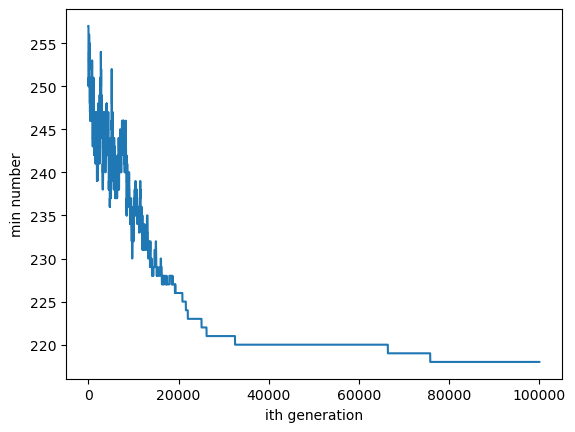

In [250]:
import matplotlib.pyplot as plt
plt.plot(x, y)
plt.xlabel("ith generation")
plt.ylabel("min number")

plt.show()

# تحلیل
همانطور که مشاهده میکنیم، مانند تست کیس های قبل بعد از گذشت نسل نسبتا کمی به جواب خواسته شده میرسیم. یه نکته جالبی که در نمودار وجود دارد این است که میزان بالا و پایین شدن فیتنس در نسل های اولیه، به شدت زیاد است و نوسان دارد. حال هر جه دما سردتر میشود، تابع احتمال انتخاب رندوم ما نیز کمتر شده و این نوسان نیز کم میشود. به طور کلی، این الگوریتم در مقایسه با الگوریتم های قبلی، در ایتریشن های دیرتری به جواب میرسد. امااااا، از انجا که محاسبات بسیار کمی دارد، زمان رسیدن به جواب، از خیلی از الگوریتم ها، مانند PSO یا ژنتیک الگوریتم، بسیار کمتر و در حدود چند ثانیه است.
همچنین همانطور که پیش تر گفتم، بدلیل کم بودن تفاوت سولوشن های مختلفمان در این مسئله، شکل مسئله پلکانی میشود درصورتی که در مسئله TSP نمودار بیشتر شبیه یک نمودار با y های پیوسته بود.
همچنین، بدون تغییر دادن پارامتر ها نسبت به تست کیس قبلی، به جواب خواسته شده میرسیم.
نکته دیگر در این سوال این است که حتی در ایتریشن های بسیار اولیه هم، جواب های خیلی خوبی میگیریم.
 و در ایتریشن ۲۰۰۰۰ یه جواب خواسته شده و در ایتریشن ۴۰۰۰۰ به جواب خیلی خوبی میرسیم.
****************************************************************************************************